In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import pickle
import random
from tqdm import tqdm
import re
from collections import Counter

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.nn.utils.rnn import pack_padded_sequence, pad_packed_sequence
import torchvision.transforms as transforms
import torchvision.models as models

import nltk
try:
    from nltk.translate.bleu_score import corpus_bleu
except:
    nltk.download('punkt')
    from nltk.translate.bleu_score import corpus_bleu

# Setup
if torch.cuda.is_available():
    torch.cuda.empty_cache()

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")

torch.manual_seed(42)
np.random.seed(42)
random.seed(42)



Device: cuda


### CONFIGURATION

In [4]:
CONFIG = {
    'encoder_dim': 2048,
    'attention_dim': 512,
    'embed_dim': 512,
    'decoder_dim': 512,
    'vocab_size': 0,  # Will be set after building vocab
    'dropout': 0.5,
    'learning_rate': 4e-4,
    'batch_size': 32,
    'num_epochs': 60,
    'grad_clip': 5.0,
}

PATHS = {
    'images': '/kaggle/input/flickr8k/Images',
    'captions': '/kaggle/input/flickr8k/captions.txt',
    'output': '/kaggle/working/outputs',
}

os.makedirs(PATHS['output'], exist_ok=True)

### DATA LOADING

In [5]:
print("Loading data...")

def load_captions(file_path):
    data = {}
    with open(file_path, 'r', encoding='utf-8') as f:
        next(f)  # Skip header
        for line in f:
            line = line.strip()
            if not line:
                continue
            parts = line.split(',', 1)
            if len(parts) != 2:
                continue
            
            img_name, caption = parts
            img_id = img_name.split('.')[0]
            
            # Clean caption
            caption = caption.lower().strip()
            caption = re.sub(r'[^a-z\s]', '', caption)
            caption = ' '.join(caption.split())
            
            if img_id not in data:
                data[img_id] = []
            data[img_id].append(caption)
    
    print(f" Loaded {len(data)} images")
    return data

captions_data = load_captions(PATHS['captions'])

Loading data...
 Loaded 8091 images


### VOCABULARY

In [6]:
print("Building vocabulary...")

class Vocab:
    def __init__(self):
        self.word2idx = {}
        self.idx2word = {}
        self.idx = 0
        
        # Add special tokens
        for token in ['<pad>', '<start>', '<end>', '<unk>']:
            self.add_word(token)
    
    def add_word(self, word):
        if word not in self.word2idx:
            self.word2idx[word] = self.idx
            self.idx2word[self.idx] = word
            self.idx += 1
    
    def __call__(self, word):
        return self.word2idx.get(word, self.word2idx['<unk>'])
    
    def __len__(self):
        return len(self.word2idx)


word_freq = Counter()
for captions in captions_data.values():
    for caption in captions:
        word_freq.update(caption.split())

vocab = Vocab()
for word, freq in word_freq.items():
    if freq >= 5:  # Threshold
        vocab.add_word(word)

print(f" Vocabulary size: {len(vocab)}")
CONFIG['vocab_size'] = len(vocab)


with open(os.path.join(PATHS['output'], 'vocab.pkl'), 'wb') as f:
    pickle.dump(vocab, f)

Building vocabulary...
 Vocabulary size: 2988


### DATASET

In [7]:
class FlickrDataset(Dataset):
    def __init__(self, image_dir, captions_data, vocab, split_ids, transform=None):
        self.image_dir = image_dir
        self.vocab = vocab
        self.transform = transform
        
        self.images = []
        self.captions = []
        self.caplens = []
        
        for img_id in split_ids:
            if img_id in captions_data:
                for caption in captions_data[img_id]:
                    self.images.append(img_id)
                    
                    # Convert caption to indices
                    tokens = ['<start>'] + caption.split() + ['<end>']
                    caption_vec = [vocab(token) for token in tokens]
                    
                    self.captions.append(caption_vec)
                    self.caplens.append(len(caption_vec))
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        img_id = self.images[idx]
        caption = self.captions[idx]
        caplen = self.caplens[idx]
        
        # Load image
        img_path = os.path.join(self.image_dir, f"{img_id}.jpg")
        img = Image.open(img_path).convert('RGB')
        
        if self.transform:
            img = self.transform(img)
        
        return img, torch.LongTensor(caption), caplen

def collate_fn(batch):
    # Sort by caption length
    batch.sort(key=lambda x: x[2], reverse=True)
    
    images, captions, caplens = zip(*batch)
    images = torch.stack(images, 0)
    
    # Pad captions
    max_len = max(caplens)
    padded_captions = torch.zeros(len(captions), max_len).long()
    
    for i, cap in enumerate(captions):
        end = caplens[i]
        padded_captions[i, :end] = cap[:end]
    
    return images, padded_captions, list(caplens)

# Transforms
train_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.RandomCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Split data
all_ids = list(captions_data.keys())
random.shuffle(all_ids)
split = int(0.9 * len(all_ids))
train_ids = all_ids[:split]
val_ids = all_ids[split:]

print(f"Creating datasets...")
train_dataset = FlickrDataset(PATHS['images'], captions_data, vocab, train_ids, train_transform)
val_dataset = FlickrDataset(PATHS['images'], captions_data, vocab, val_ids, val_transform)

train_loader = DataLoader(train_dataset, batch_size=CONFIG['batch_size'], 
                          shuffle=True, num_workers=4, collate_fn=collate_fn, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=CONFIG['batch_size'], 
                        shuffle=False, num_workers=4, collate_fn=collate_fn, pin_memory=True)

print(f" Train: {len(train_dataset)}, Val: {len(val_dataset)}")

Creating datasets...
 Train: 36405, Val: 4050


### MODEL - ENCODER WITH ATTENTION

In [9]:
class Encoder(nn.Module):
    def __init__(self, encoded_size=14):
        super().__init__()
        
        # Load pretrained ResNet-101
        resnet = models.resnet101(pretrained=True)
        
        # Remove linear and pool layers
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        
        # Adaptive pooling to fixed size
        self.adaptive_pool = nn.AdaptiveAvgPool2d((encoded_size, encoded_size))
        
        # Fine-tune only last 2 blocks
        for param in self.resnet.parameters():
            param.requires_grad = False
        
        for module in list(self.resnet.children())[6:]:
            for param in module.parameters():
                param.requires_grad = True
    
    def forward(self, images):
        features = self.resnet(images)  # (batch, 2048, H, W)
        features = self.adaptive_pool(features)  # (batch, 2048, 14, 14)
        features = features.permute(0, 2, 3, 1)  # (batch, 14, 14, 2048)
        batch_size = features.size(0)
        features = features.view(batch_size, -1, 2048)  # (batch, 196, 2048)
        return features


### ATTENTION MECHANISM

In [10]:
class Attention(nn.Module):
    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        super().__init__()
        self.encoder_att = nn.Linear(encoder_dim, attention_dim)
        self.decoder_att = nn.Linear(decoder_dim, attention_dim)
        self.full_att = nn.Linear(attention_dim, 1)
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)
    
    def forward(self, encoder_out, decoder_hidden):
        att1 = self.encoder_att(encoder_out)  # (batch, num_pixels, attention_dim)
        att2 = self.decoder_att(decoder_hidden)  # (batch, attention_dim)
        att = self.full_att(self.relu(att1 + att2.unsqueeze(1))).squeeze(2)  # (batch, num_pixels)
        alpha = self.softmax(att)  # (batch, num_pixels)
        context = (encoder_out * alpha.unsqueeze(2)).sum(dim=1)  # (batch, encoder_dim)
        return context, alpha

### DECODER WITH ATTENTION

In [11]:
class DecoderWithAttention(nn.Module):
    def __init__(self, attention_dim, embed_dim, decoder_dim, vocab_size, encoder_dim=2048, dropout=0.5):
        super().__init__()
        
        self.encoder_dim = encoder_dim
        self.attention_dim = attention_dim
        self.embed_dim = embed_dim
        self.decoder_dim = decoder_dim
        self.vocab_size = vocab_size
        self.dropout = dropout
        
        self.attention = Attention(encoder_dim, decoder_dim, attention_dim)
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.dropout_layer = nn.Dropout(dropout)
        
        self.decode_step = nn.LSTMCell(embed_dim + encoder_dim, decoder_dim)
        self.init_h = nn.Linear(encoder_dim, decoder_dim)
        self.init_c = nn.Linear(encoder_dim, decoder_dim)
        
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        self.sigmoid = nn.Sigmoid()
        
        self.fc = nn.Linear(decoder_dim, vocab_size)
        
        self.init_weights()
    
    def init_weights(self):
        self.embedding.weight.data.uniform_(-0.1, 0.1)
        self.fc.bias.data.fill_(0)
        self.fc.weight.data.uniform_(-0.1, 0.1)
    
    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)
        c = self.init_c(mean_encoder_out)
        return h, c
    
    def forward(self, encoder_out, captions, caption_lengths):
        batch_size = encoder_out.size(0)
        num_pixels = encoder_out.size(1)
        
        # Sort by length
        caption_lengths, sort_idx = caption_lengths.sort(dim=0, descending=True)
        encoder_out = encoder_out[sort_idx]
        captions = captions[sort_idx]
        
        # Embedding
        embeddings = self.embedding(captions)  # (batch, max_len, embed_dim)
        
        # Initialize LSTM state
        h, c = self.init_hidden_state(encoder_out)
        
        decode_lengths = (caption_lengths - 1).tolist()
        
        # Tensors to hold predictions and alphas
        predictions = torch.zeros(batch_size, max(decode_lengths), self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, max(decode_lengths), num_pixels).to(device)
        
        # Decode
        for t in range(max(decode_lengths)):
            batch_size_t = sum([l > t for l in decode_lengths])
            
            # Attention
            context, alpha = self.attention(encoder_out[:batch_size_t], h[:batch_size_t])
            
            # Gating
            gate = self.sigmoid(self.f_beta(h[:batch_size_t]))
            context = gate * context
            
            # LSTM step
            h, c = self.decode_step(
                torch.cat([embeddings[:batch_size_t, t, :], context], dim=1),
                (h[:batch_size_t], c[:batch_size_t])
            )
            
            # Prediction
            preds = self.fc(self.dropout_layer(h))
            predictions[:batch_size_t, t, :] = preds
            alphas[:batch_size_t, t, :] = alpha
        
        return predictions, captions, decode_lengths, alphas, sort_idx

# Initialize models
print("\nInitializing models...")
encoder = Encoder().to(device)
decoder = DecoderWithAttention(
    CONFIG['attention_dim'],
    CONFIG['embed_dim'],
    CONFIG['decoder_dim'],
    CONFIG['vocab_size'],
    CONFIG['encoder_dim'],
    CONFIG['dropout']
).to(device)

encoder_params = sum(p.numel() for p in encoder.parameters() if p.requires_grad)
decoder_params = sum(p.numel() for p in decoder.parameters())
print(f" Encoder trainable params: {encoder_params:,}")
print(f" Decoder params: {decoder_params:,}")


Initializing models...


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth
100%|██████████| 171M/171M [00:00<00:00, 208MB/s] 


 Encoder trainable params: 41,055,232
 Decoder params: 13,819,309


### TRAINING

In [13]:
criterion = nn.CrossEntropyLoss().to(device)
optimizer = optim.Adam(
    params=filter(lambda p: p.requires_grad, list(encoder.parameters()) + list(decoder.parameters())),
    lr=CONFIG['learning_rate']
)

def train_epoch(encoder, decoder, dataloader, criterion, optimizer):
    encoder.train()
    decoder.train()
    
    total_loss = 0
    for imgs, caps, caplens in tqdm(dataloader, desc="Training"):
        imgs = imgs.to(device)
        caps = caps.to(device)
        caplens = torch.LongTensor(caplens).to(device)
        
        # Forward
        img_features = encoder(imgs)
        scores, caps_sorted, decode_lengths, alphas, sort_idx = decoder(img_features, caps, caplens)
        
        # Target
        targets = caps_sorted[:, 1:]
        
        # Pack
        scores = pack_padded_sequence(scores, decode_lengths, batch_first=True)[0]
        targets = pack_padded_sequence(targets, decode_lengths, batch_first=True)[0]
        
        # Loss
        loss = criterion(scores, targets)
        
        # Add doubly stochastic attention regularization
        loss += 1.0 * ((1.0 - alphas.sum(dim=1)) ** 2).mean()
        
        # Backward
        optimizer.zero_grad()
        loss.backward()
        
        # Clip gradients
        torch.nn.utils.clip_grad_norm_(filter(lambda p: p.requires_grad, decoder.parameters()), CONFIG['grad_clip'])
        
        optimizer.step()
        
        total_loss += loss.item()
    
    return total_loss / len(dataloader)

def validate(encoder, decoder, dataloader, criterion):
    encoder.eval()
    decoder.eval()
    
    total_loss = 0
    with torch.no_grad():
        for imgs, caps, caplens in tqdm(dataloader, desc="Validating"):
            imgs = imgs.to(device)
            caps = caps.to(device)
            caplens = torch.LongTensor(caplens).to(device)
            
            img_features = encoder(imgs)
            scores, caps_sorted, decode_lengths, alphas, sort_idx = decoder(img_features, caps, caplens)
            
            targets = caps_sorted[:, 1:]
            scores = pack_padded_sequence(scores, decode_lengths, batch_first=True)[0]
            targets = pack_padded_sequence(targets, decode_lengths, batch_first=True)[0]
            
            loss = criterion(scores, targets)
            loss += 1.0 * ((1.0 - alphas.sum(dim=1)) ** 2).mean()
            
            total_loss += loss.item()
    
    return total_loss / len(dataloader)

### CAPTION GENERATION WITH BEAM SEARCH

In [15]:
def generate_caption(encoder, decoder, image_path, vocab, transform, beam_size=3):
    encoder.eval()
    decoder.eval()
    
    # Load image
    img = Image.open(image_path).convert('RGB')
    img = transform(img).unsqueeze(0).to(device)
    
    with torch.no_grad():
        # Encode
        encoder_out = encoder(img)  # (1, num_pixels, encoder_dim)
        num_pixels = encoder_out.size(1)
        encoder_dim = encoder_out.size(2)
        
        # Expand for beam search
        encoder_out = encoder_out.expand(beam_size, num_pixels, encoder_dim)
        
        # Initialize
        k_prev_words = torch.LongTensor([[vocab('<start>')]] * beam_size).to(device)
        seqs = k_prev_words
        top_k_scores = torch.zeros(beam_size, 1).to(device)
        
        complete_seqs = []
        complete_seqs_scores = []
        
        # Start decoding
        step = 1
        h, c = decoder.init_hidden_state(encoder_out)
        
        while True:
            embeddings = decoder.embedding(k_prev_words).squeeze(1)
            
            context, alpha = decoder.attention(encoder_out, h)
            gate = decoder.sigmoid(decoder.f_beta(h))
            context = gate * context
            
            h, c = decoder.decode_step(torch.cat([embeddings, context], dim=1), (h, c))
            
            scores = decoder.fc(h)
            scores = F.log_softmax(scores, dim=1)
            
            scores = top_k_scores.expand_as(scores) + scores
            
            if step == 1:
                top_k_scores, top_k_words = scores[0].topk(beam_size, 0, True, True)
            else:
                top_k_scores, top_k_words = scores.view(-1).topk(beam_size, 0, True, True)
            
            prev_word_inds = (top_k_words // len(vocab)).long()
            next_word_inds = (top_k_words % len(vocab)).long()
            
            seqs = torch.cat([seqs[prev_word_inds], next_word_inds.unsqueeze(1)], dim=1)
            
            incomplete_inds = [ind for ind, next_word in enumerate(next_word_inds) if next_word != vocab('<end>')]
            complete_inds = list(set(range(len(next_word_inds))) - set(incomplete_inds))
            
            if len(complete_inds) > 0:
                complete_seqs.extend(seqs[complete_inds].tolist())
                complete_seqs_scores.extend(top_k_scores[complete_inds])
            
            beam_size -= len(complete_inds)
            
            if beam_size == 0:
                break
            
            seqs = seqs[incomplete_inds]
            h = h[prev_word_inds[incomplete_inds]]
            c = c[prev_word_inds[incomplete_inds]]
            encoder_out = encoder_out[prev_word_inds[incomplete_inds]]
            top_k_scores = top_k_scores[incomplete_inds].unsqueeze(1)
            k_prev_words = next_word_inds[incomplete_inds].unsqueeze(1)
            
            if step > 50:
                break
            step += 1
        
        if len(complete_seqs_scores) > 0:
            i = complete_seqs_scores.index(max(complete_seqs_scores))
            seq = complete_seqs[i]
        else:
            seq = seqs[0].tolist()
        
        # Convert to words
        words = [vocab.idx2word[idx] for idx in seq if idx not in [vocab('<start>'), vocab('<end>'), vocab('<pad>')]]
        caption = ' '.join(words)
        
        return caption


### EVALUATION

In [17]:
def evaluate_model(encoder, decoder, val_ids, captions_data, vocab, transform):
    print("\nEvaluating model...")
    
    references = []
    hypotheses = []
    
    sample_ids = random.sample(val_ids, min(100, len(val_ids)))
    
    for img_id in tqdm(sample_ids):
        img_path = os.path.join(PATHS['images'], f"{img_id}.jpg")
        
        try:
            # Generate caption
            pred = generate_caption(encoder, decoder, img_path, vocab, transform, beam_size=3)
            pred_words = pred.split()
            
            # Get references
            refs = [cap.split() for cap in captions_data[img_id]]
            
            references.append(refs)
            hypotheses.append(pred_words)
        except:
            continue
    
    # Calculate BLEU
    bleu1 = corpus_bleu(references, hypotheses, weights=(1, 0, 0, 0))
    bleu2 = corpus_bleu(references, hypotheses, weights=(0.5, 0.5, 0, 0))
    bleu3 = corpus_bleu(references, hypotheses, weights=(0.33, 0.33, 0.33, 0))
    bleu4 = corpus_bleu(references, hypotheses, weights=(0.25, 0.25, 0.25, 0.25))
    
    print(f"\n BLEU Scores:")
    print(f"  BLEU-1: {bleu1:.4f}")
    print(f"  BLEU-2: {bleu2:.4f}")
    print(f"  BLEU-3: {bleu3:.4f}")
    print(f"  BLEU-4: {bleu4:.4f}")
    
    return bleu1, bleu2, bleu3, bleu4

def visualize_results(encoder, decoder, val_ids, captions_data, vocab, transform, num=5):
    sample_ids = random.sample(val_ids, min(num, len(val_ids)))
    
    fig, axes = plt.subplots(num, 1, figsize=(12, 4*num))
    if num == 1:
        axes = [axes]
    
    for i, img_id in enumerate(sample_ids):
        img_path = os.path.join(PATHS['images'], f"{img_id}.jpg")
        
        # Generate
        pred = generate_caption(encoder, decoder, img_path, vocab, transform, beam_size=5)
        actual = captions_data[img_id][0]
        
        # Display
        img = Image.open(img_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Generated: {pred}\nActual: {actual}", fontsize=10, loc='left', wrap=True)
    
    plt.tight_layout()
    plt.savefig(os.path.join(PATHS['output'], 'results.png'), dpi=150)
    plt.show()
    print(f" Saved to {PATHS['output']}/results.png")

### MAIN TRAINING LOOP


STARTING TRAINING

Epoch 1/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 4.8251 | Val Loss: 4.2202

Epoch 2/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 4.1113 | Val Loss: 3.9395

Epoch 3/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 3.8642 | Val Loss: 3.8035

Epoch 4/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.49it/s]


Train Loss: 3.7015 | Val Loss: 3.7153

Epoch 5/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 3.5778 | Val Loss: 3.6650

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 27.67it/s]



 BLEU Scores:
  BLEU-1: 0.6178
  BLEU-2: 0.4323
  BLEU-3: 0.3026
  BLEU-4: 0.2031
 Best model saved! BLEU-4: 0.2031


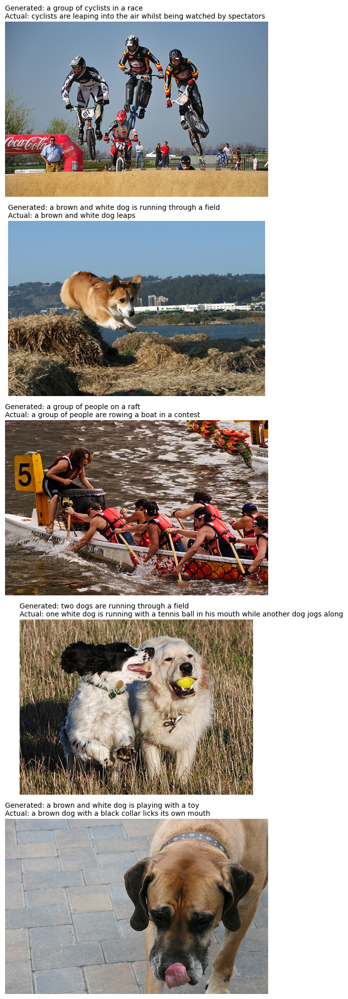

 Saved to /kaggle/working/outputs/results.png

Epoch 6/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 3.4728 | Val Loss: 3.6210

Epoch 7/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 3.3798 | Val Loss: 3.6002

Epoch 8/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 3.2981 | Val Loss: 3.5809

Epoch 9/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 3.2228 | Val Loss: 3.5756

Epoch 10/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.54it/s]


Train Loss: 3.1483 | Val Loss: 3.5722

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 28.73it/s]



 BLEU Scores:
  BLEU-1: 0.6443
  BLEU-2: 0.4649
  BLEU-3: 0.3312
  BLEU-4: 0.2292
 Best model saved! BLEU-4: 0.2292


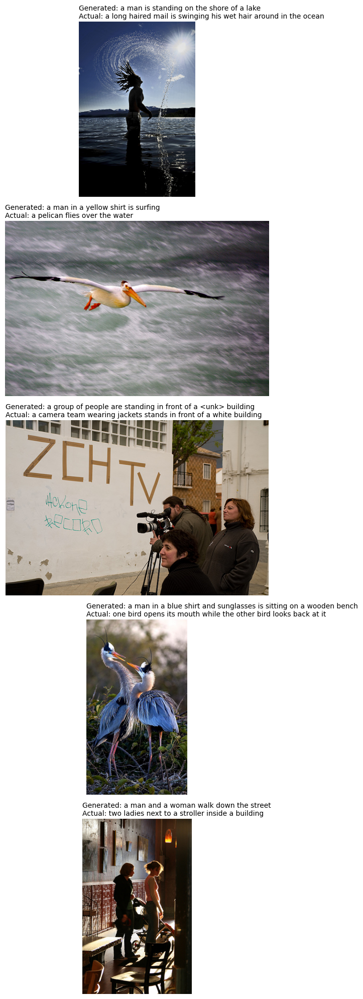

 Saved to /kaggle/working/outputs/results.png

Epoch 11/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.54it/s]


Train Loss: 3.0795 | Val Loss: 3.5703

Epoch 12/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 3.0105 | Val Loss: 3.5736

Epoch 13/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 2.9479 | Val Loss: 3.5863

Epoch 14/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 2.8900 | Val Loss: 3.5974

Epoch 15/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 2.8262 | Val Loss: 3.6118

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 27.45it/s]



 BLEU Scores:
  BLEU-1: 0.6324
  BLEU-2: 0.4678
  BLEU-3: 0.3496
  BLEU-4: 0.2534
 Best model saved! BLEU-4: 0.2534


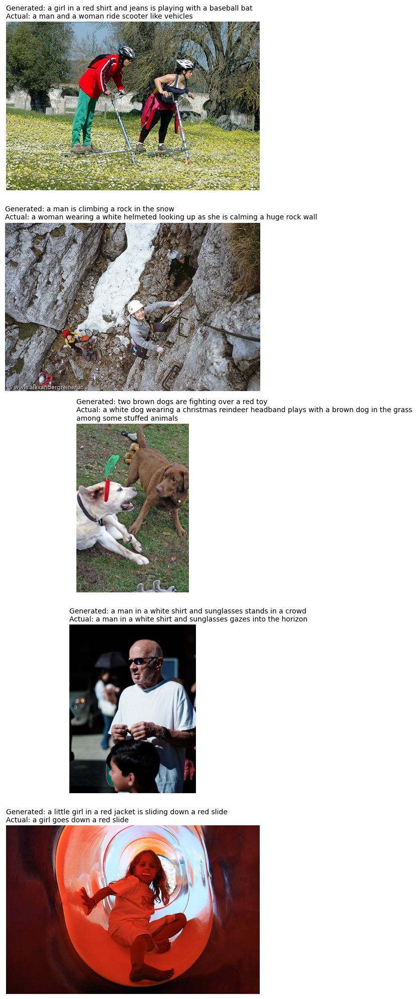

 Saved to /kaggle/working/outputs/results.png

Epoch 16/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.54it/s]


Train Loss: 2.7668 | Val Loss: 3.6296

Epoch 17/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.54it/s]


Train Loss: 2.7087 | Val Loss: 3.6476

Epoch 18/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 2.6559 | Val Loss: 3.6679

Epoch 19/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 2.6009 | Val Loss: 3.6879

Epoch 20/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 2.5500 | Val Loss: 3.7190

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 27.58it/s]



 BLEU Scores:
  BLEU-1: 0.6041
  BLEU-2: 0.4311
  BLEU-3: 0.3006
  BLEU-4: 0.2042


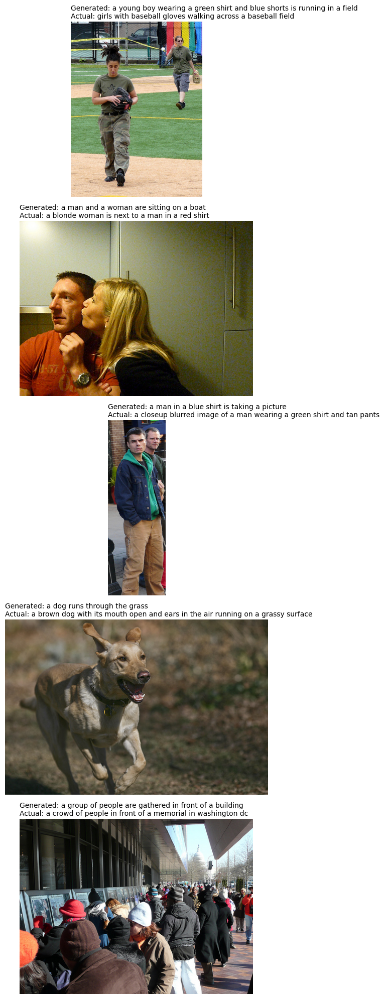

 Saved to /kaggle/working/outputs/results.png

Epoch 21/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.54it/s]


Train Loss: 2.4993 | Val Loss: 3.7306

Epoch 22/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.54it/s]


Train Loss: 2.4573 | Val Loss: 3.7523

Epoch 23/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 2.3972 | Val Loss: 3.7821

Epoch 24/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 2.3513 | Val Loss: 3.8236

Epoch 25/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 2.3108 | Val Loss: 3.8405

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 26.22it/s]



 BLEU Scores:
  BLEU-1: 0.6205
  BLEU-2: 0.4376
  BLEU-3: 0.3119
  BLEU-4: 0.2126


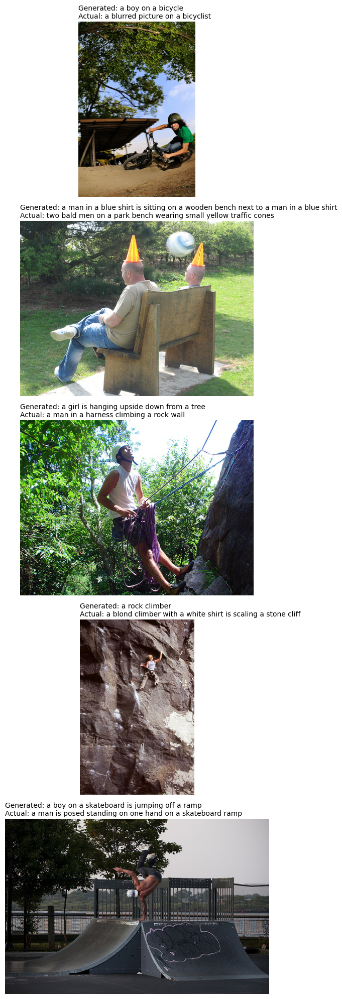

 Saved to /kaggle/working/outputs/results.png

Epoch 26/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 2.2704 | Val Loss: 3.8682

Epoch 27/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 2.2313 | Val Loss: 3.8849

Epoch 28/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 2.1914 | Val Loss: 3.9313

Epoch 29/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 2.1629 | Val Loss: 3.9626

Epoch 30/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 2.1154 | Val Loss: 3.9801

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 26.19it/s]



 BLEU Scores:
  BLEU-1: 0.5807
  BLEU-2: 0.4137
  BLEU-3: 0.2863
  BLEU-4: 0.1848


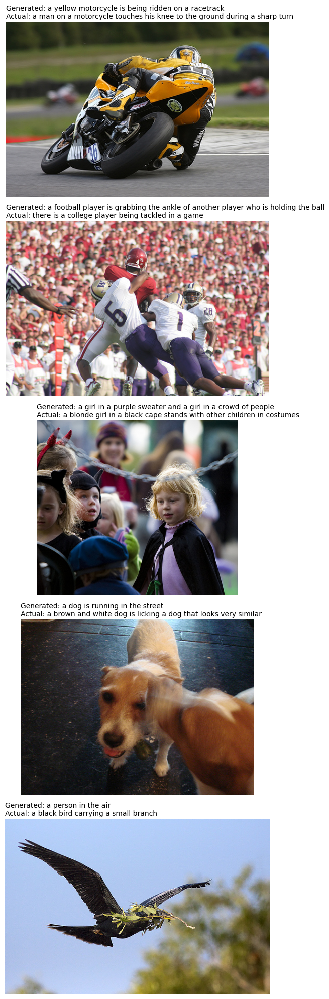

 Saved to /kaggle/working/outputs/results.png

Epoch 31/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 2.0815 | Val Loss: 4.0136

Epoch 32/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.55it/s]


Train Loss: 2.0680 | Val Loss: 4.0169

Epoch 33/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 2.0215 | Val Loss: 4.0629

Epoch 34/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 1.9949 | Val Loss: 4.1027

Epoch 35/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 1.9622 | Val Loss: 4.1212

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 25.99it/s]



 BLEU Scores:
  BLEU-1: 0.5977
  BLEU-2: 0.4181
  BLEU-3: 0.2885
  BLEU-4: 0.1917


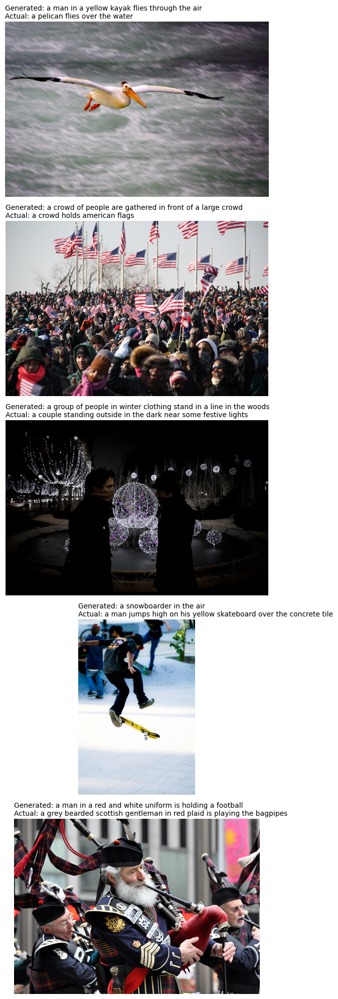

 Saved to /kaggle/working/outputs/results.png

Epoch 36/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.49it/s]


Train Loss: 1.9386 | Val Loss: 4.1628

Epoch 37/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.50it/s]


Train Loss: 1.9114 | Val Loss: 4.1656

Epoch 38/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 1.8910 | Val Loss: 4.2023

Epoch 39/60


Validating: 100%|██████████| 127/127 [00:17<00:00,  7.41it/s]


Train Loss: 1.8722 | Val Loss: 4.2294

Epoch 40/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.50it/s]


Train Loss: 1.8459 | Val Loss: 4.2640

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 25.39it/s]



 BLEU Scores:
  BLEU-1: 0.5916
  BLEU-2: 0.4223
  BLEU-3: 0.3021
  BLEU-4: 0.2054


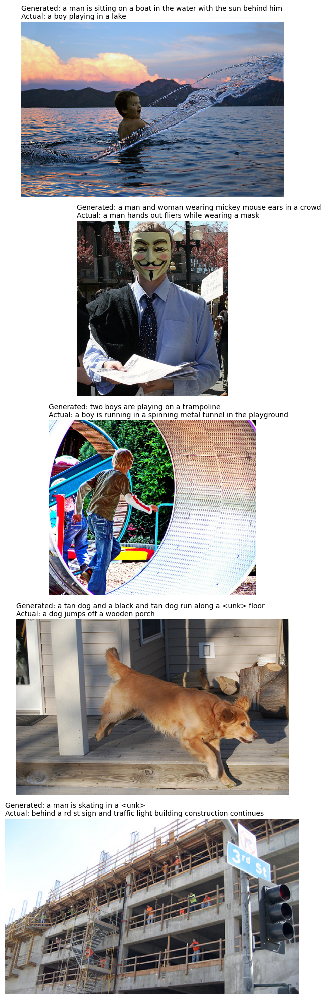

 Saved to /kaggle/working/outputs/results.png

Epoch 41/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.49it/s]


Train Loss: 1.8249 | Val Loss: 4.2703

Epoch 42/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.50it/s]


Train Loss: 1.8072 | Val Loss: 4.2981

Epoch 43/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.48it/s]


Train Loss: 1.7852 | Val Loss: 4.3261

Epoch 44/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.50it/s]


Train Loss: 1.7676 | Val Loss: 4.3486

Epoch 45/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 1.7507 | Val Loss: 4.3864

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 27.33it/s]



 BLEU Scores:
  BLEU-1: 0.6039
  BLEU-2: 0.4269
  BLEU-3: 0.2962
  BLEU-4: 0.1928


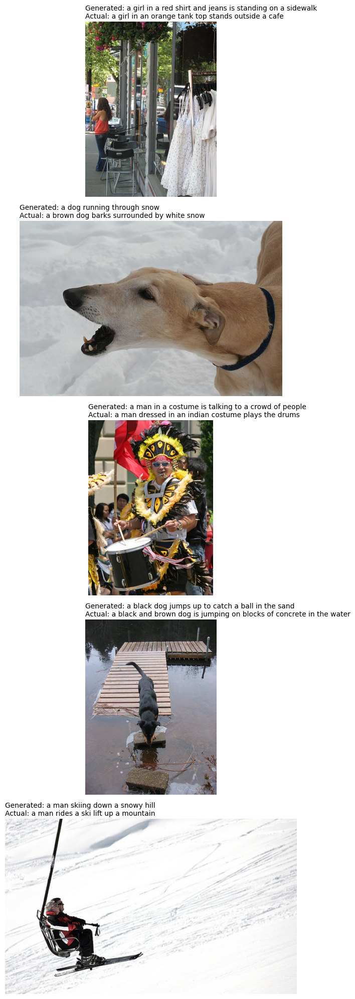

 Saved to /kaggle/working/outputs/results.png

Epoch 46/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.50it/s]


Train Loss: 1.7319 | Val Loss: 4.3872

Epoch 47/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.50it/s]


Train Loss: 1.7181 | Val Loss: 4.4213

Epoch 48/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 1.7052 | Val Loss: 4.4371

Epoch 49/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 1.6914 | Val Loss: 4.4518

Epoch 50/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 1.6757 | Val Loss: 4.4690

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 26.95it/s]



 BLEU Scores:
  BLEU-1: 0.5844
  BLEU-2: 0.4203
  BLEU-3: 0.2993
  BLEU-4: 0.2074


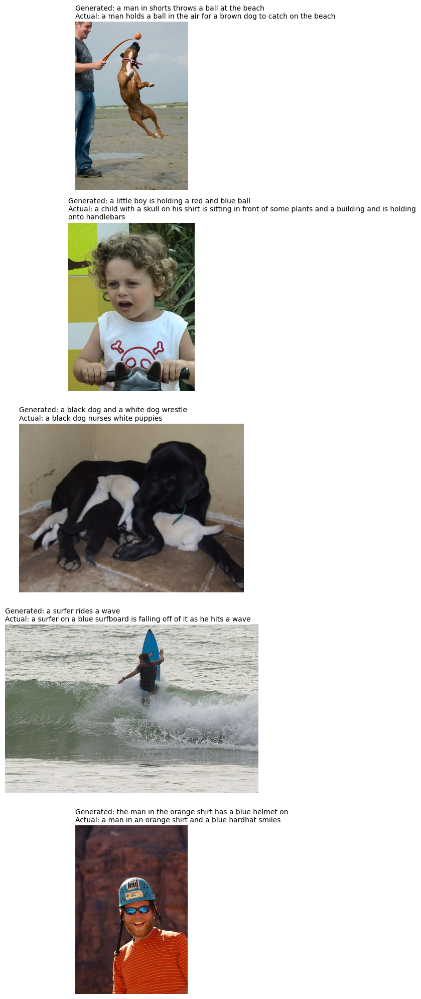

 Saved to /kaggle/working/outputs/results.png

Epoch 51/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.51it/s]


Train Loss: 1.6618 | Val Loss: 4.4926

Epoch 52/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 1.6487 | Val Loss: 4.5090

Epoch 53/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 1.6389 | Val Loss: 4.5339

Epoch 54/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.54it/s]


Train Loss: 1.6256 | Val Loss: 4.5707

Epoch 55/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.52it/s]


Train Loss: 1.6178 | Val Loss: 4.5888

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 27.65it/s]



 BLEU Scores:
  BLEU-1: 0.5919
  BLEU-2: 0.4213
  BLEU-3: 0.2960
  BLEU-4: 0.2043


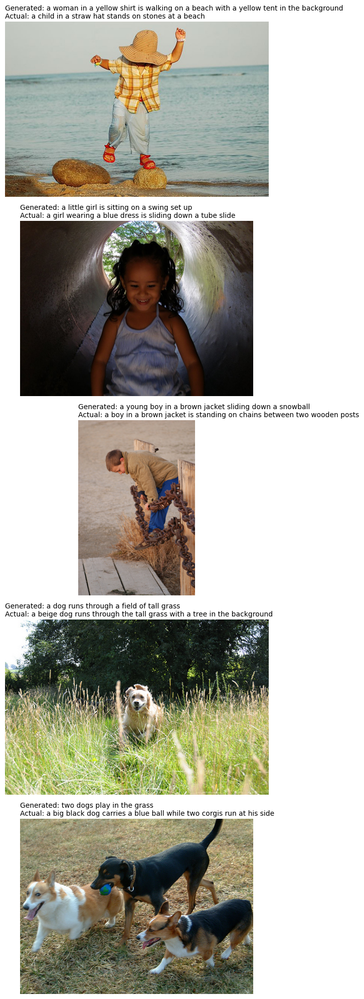

 Saved to /kaggle/working/outputs/results.png

Epoch 56/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.53it/s]


Train Loss: 1.6050 | Val Loss: 4.6043

Epoch 57/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.48it/s]


Train Loss: 1.5900 | Val Loss: 4.6216

Epoch 58/60


Validating: 100%|██████████| 127/127 [00:17<00:00,  7.37it/s]


Train Loss: 1.5852 | Val Loss: 4.6522

Epoch 59/60


Validating: 100%|██████████| 127/127 [00:17<00:00,  7.32it/s]


Train Loss: 1.5753 | Val Loss: 4.6442

Epoch 60/60


Validating: 100%|██████████| 127/127 [00:16<00:00,  7.49it/s]


Train Loss: 1.5682 | Val Loss: 4.6619

Evaluating model...


100%|██████████| 100/100 [00:03<00:00, 25.52it/s]



 BLEU Scores:
  BLEU-1: 0.5534
  BLEU-2: 0.3733
  BLEU-3: 0.2515
  BLEU-4: 0.1684


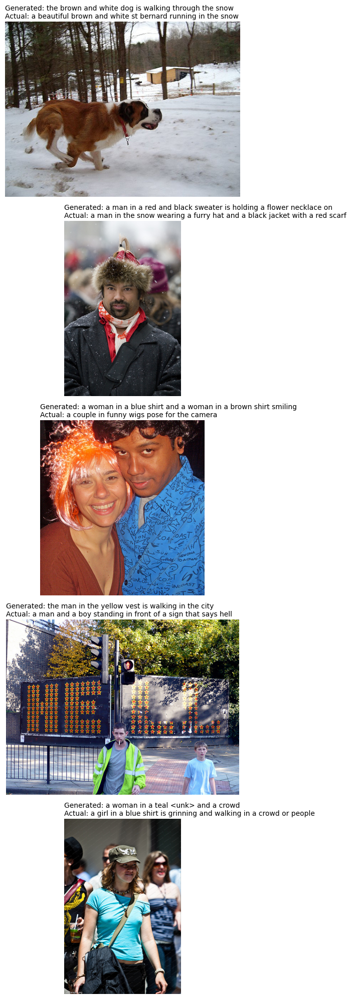

 Saved to /kaggle/working/outputs/results.png


In [18]:
print("\n" + "="*70)
print("STARTING TRAINING")
print("="*70)

best_bleu4 = 0
history = {'train_loss': [], 'val_loss': [], 'bleu4': []}

for epoch in range(CONFIG['num_epochs']):
    print(f"\nEpoch {epoch+1}/{CONFIG['num_epochs']}")
    
    train_loss = train_epoch(encoder, decoder, train_loader, criterion, optimizer)
    val_loss = validate(encoder, decoder, val_loader, criterion)
    
    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")
    
    # Evaluate every 5 epochs
    if (epoch + 1) % 5 == 0:
        bleu1, bleu2, bleu3, bleu4 = evaluate_model(encoder, decoder, val_ids, captions_data, vocab, val_transform)
        history['bleu4'].append(bleu4)
        
        if bleu4 > best_bleu4:
            best_bleu4 = bleu4
            
            # Save best model
            torch.save({
                'epoch': epoch,
                'encoder': encoder.state_dict(),
                'decoder': decoder.state_dict(),
                'optimizer': optimizer.state_dict(),
                'bleu4': bleu4,
                'vocab': vocab,
                'config': CONFIG
            }, os.path.join(PATHS['output'], 'best_model.pth'))
            
            print(f" Best model saved! BLEU-4: {bleu4:.4f}")
        
        # Visualize
        visualize_results(encoder, decoder, val_ids, captions_data, vocab, val_transform, 5)
    
    # Clear cache
    if torch.cuda.is_available():
        torch.cuda.empty_cache()

### FINAL EVALUATION


FINAL EVALUATION

 Best BLEU-4: 0.2534

Generating final results...


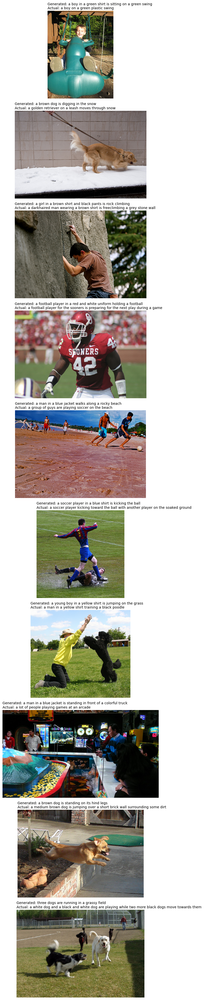

Evaluating: 100%|██████████| 100/100 [00:04<00:00, 24.90it/s]



📊 BLEU Scores:
  BLEU-1: 0.6689
  BLEU-2: 0.5038
  BLEU-3: 0.3818
  BLEU-4: 0.2818

 TRAINING COMPLETE!
Best model saved to: /kaggle/working/outputs/best_model.pth
Results saved to: /kaggle/working/outputs/results.png


In [28]:
print("\n" + "="*70)
print("FINAL EVALUATION")
print("="*70)

# Load best model (with weights_only=False for PyTorch 2.6+)
checkpoint = torch.load(os.path.join(PATHS['output'], 'best_model.pth'), weights_only=False)
encoder.load_state_dict(checkpoint['encoder'])
decoder.load_state_dict(checkpoint['decoder'])

print(f"\n Best BLEU-4: {checkpoint['bleu4']:.4f}")

# Generate final visualizations
print("\nGenerating final results...")
visualize_results(encoder, decoder, val_ids, captions_data, vocab, val_transform, 10)

# Final evaluation
final_scores = evaluate_model(encoder, decoder, val_ids, captions_data, vocab, val_transform)

print("\n" + "="*70)
print(" TRAINING COMPLETE!")
print("="*70)
print(f"Best model saved to: {PATHS['output']}/best_model.pth")
print(f"Results saved to: {PATHS['output']}/results.png")